In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tikzplotlib
from scipy.stats import norm

In [2]:
# make nice figures
# Make inline plots vector graphics
from IPython.display import set_matplotlib_formats

set_matplotlib_formats("pdf", "svg")

plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["text.usetex"] = True
plt.rcParams["text.latex.preamble"] = r"\usepackage{amsfonts} \usepackage{amsmath} \usepackage{xcolor}"

# A visual guide to conjucacy in exponential families

## The Beta distribution with Bernoulli likelihoods

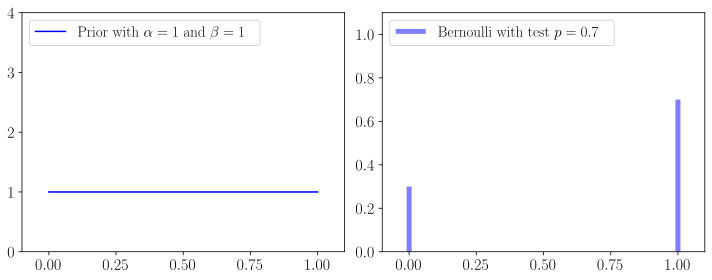

In [13]:
from scipy.stats import beta, bernoulli, binom

a_prior = 1
b_prior = 1

bernoulli_p = 0.7
bernoulli_pmf = bernoulli.pmf([0,1], bernoulli_p)

legend_size = 15

x_ = np.linspace(0,1, 1000+1)
beta_prior = beta.pdf(x_, a_prior, b_prior)

fig, ax = plt.subplots(1, 2, figsize=(10, 4))
#Beta
plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)
plt.rc('axes', labelsize=16)

ax[0].plot(x_, beta_prior, label=r'Prior with $\alpha={}$ and $\beta={}$'.format(a_prior, b_prior),
          color='blue')
ax[0].set_ylim(0, 4)
ax[0].set_xlim(-0.1, 1.1)
ax[0].legend(loc='upper left', prop={'size': legend_size})

# Bernoulli
ax[1].set_xlim(-0.1, 1.1)
ax[1].set_ylim(0, 1.1)
ax[1].vlines([0,1], 0, bernoulli_pmf, colors='b', lw=5, alpha=0.5,
            label=r'Bernoulli with test $p={}$'.format(bernoulli_p))
ax[1].legend(loc='upper left', prop={'size': legend_size})

plt.tight_layout()

plt.savefig('beta_0_prior_bernoulli.png')
plt.show();

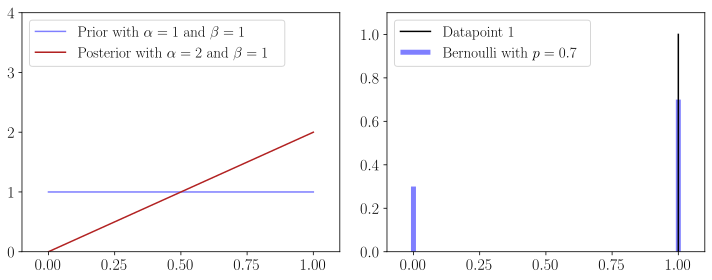

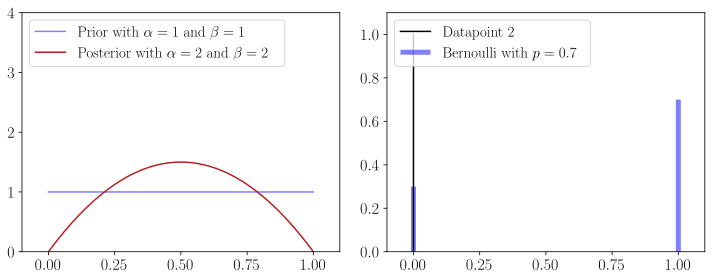

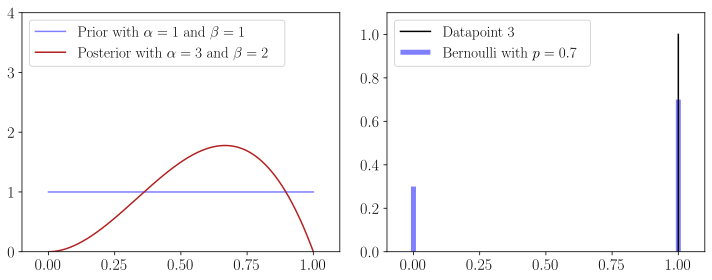

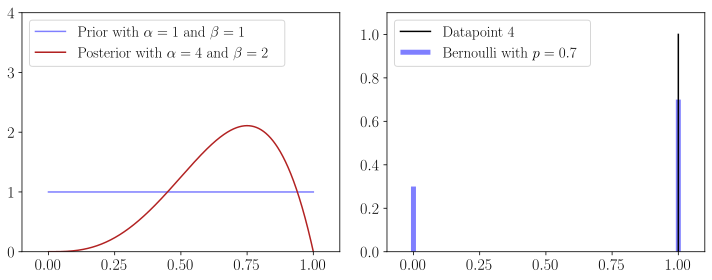

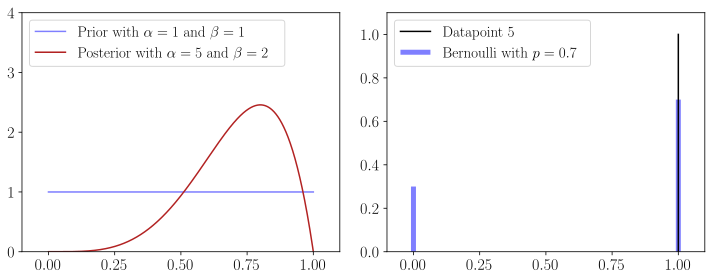

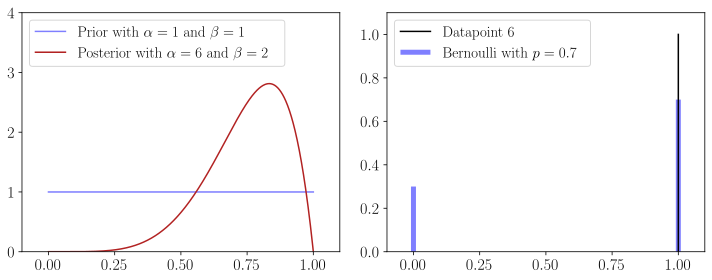

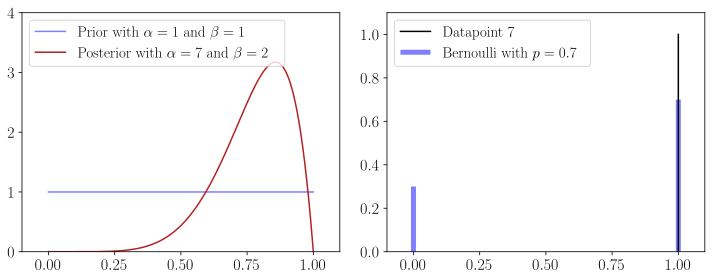

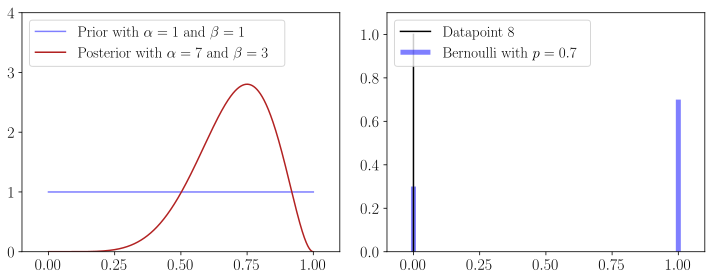

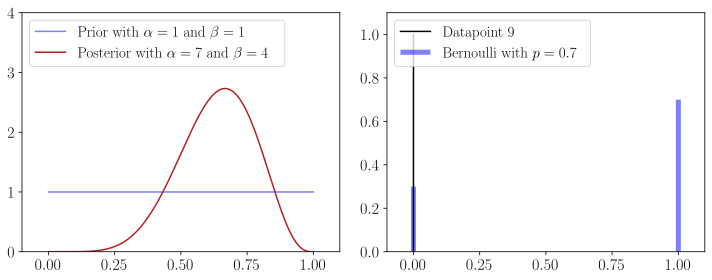

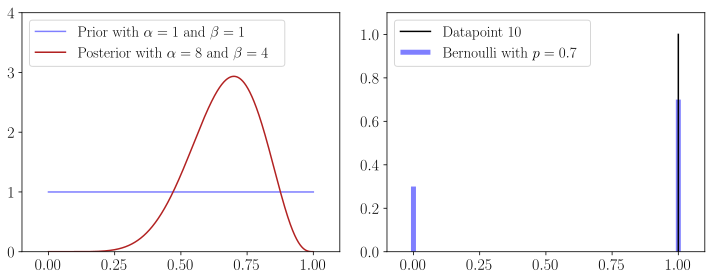

In [16]:
#show how prior shifts given new data
np.random.seed(0)

a_current = a_prior
b_current = b_prior

for i in range(10):
    
    #draw a sample, i.e. flip the coin
    bernoulli_sample = bernoulli.rvs(bernoulli_p)
    
    #update parameters
    if bernoulli_sample == 1:
        a_current+=1 
    else:
        b_current+=1
        
    beta_current = beta.pdf(x_, a_current, b_current)
    
    fig, ax = plt.subplots(1, 2, figsize=(10, 4))
    #Beta
    ax[0].plot(x_, beta_prior, label=r'Prior with $\alpha={}$ and $\beta={}$'.format(a_prior, b_prior),
              color='blue', alpha=0.5)
    ax[0].plot(x_, beta_current, label=r'Posterior with $\alpha={}$ and $\beta={}$'.format(a_current, b_current),
             alpha=1, color='firebrick')
    ax[0].set_ylim(0, 4)
    ax[0].set_xlim(-0.1, 1.1)
    ax[0].legend(loc='upper left', prop={'size': legend_size})
    #ax[0].axvline(bernoulli_p, 0, 0.5, ls='--', color='lime')

    # Bernoulli
    ax[1].set_xlim(-0.1, 1.1)
    ax[1].set_ylim(0, 1.1)
    ax[1].vlines([0,1], 0, bernoulli_pmf, colors='b', lw=5, alpha=0.5,
                label=r'Bernoulli with $p={}$'.format(bernoulli_p))
    ax[1].axvline(bernoulli_sample, 0, 10/11, color='black', label='Datapoint {}'.format(i+1))
    ax[1].legend(loc='upper left', prop={'size': legend_size})

    plt.rc('xtick', labelsize=16)
    plt.rc('ytick', labelsize=16)
    plt.rc('axes', labelsize=16)
    plt.tight_layout()
    
    plt.savefig('beta_{}_posterior_bernoulli.png'.format(i+1))
    plt.show();

## Beta distribution (with binomial likelihoods)

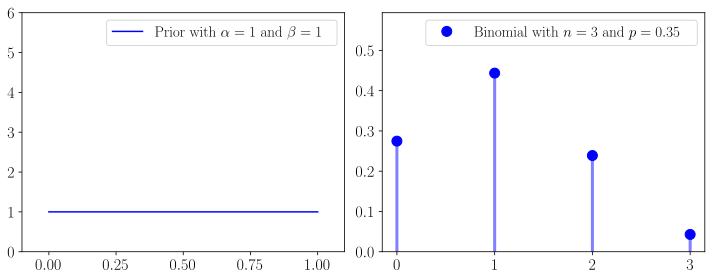

In [112]:
from scipy.stats import beta, bernoulli, binom

a_prior = 1
b_prior = 1

n_binom = 3
p_binom = 0.35

x_binom = np.arange(0, n_binom+1)
binom_pmf = binom.pmf(x_binom, n_binom, p_binom)

legend_size = 15

x_ = np.linspace(0,1, 1000+1)
beta_prior = beta.pdf(x_, a_prior, b_prior)

fig, ax = plt.subplots(1, 2, figsize=(10, 4))
ax[0].plot(x_, beta_prior, label=r'Prior with $\alpha={}$ and $\beta={}$'.format(a_prior, b_prior),
          color='blue')
ax[0].set_ylim(0, 6)
ax[0].set_xlim(-0.1, 1.1)
ax[0].legend(loc='upper right', prop={'size': legend_size})

ax[1].plot(x_binom, binom_pmf, '.', label=r'Binomial with $n= {}$ and $p={}$'.format(n_binom, p_binom),
          marker='o', markersize=10, color='blue')
ax[1].set_ylim(0, binom_pmf.max() + 0.15)
ax[1].vlines(x_binom, 0, binom_pmf, colors='b', lw=3, alpha=0.5)
ax[1].legend(loc='upper right', prop={'size': legend_size})

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)
plt.rc('axes', labelsize=16)
plt.tight_layout()

plt.savefig('beta_0_prior_binomial.png')
plt.show();

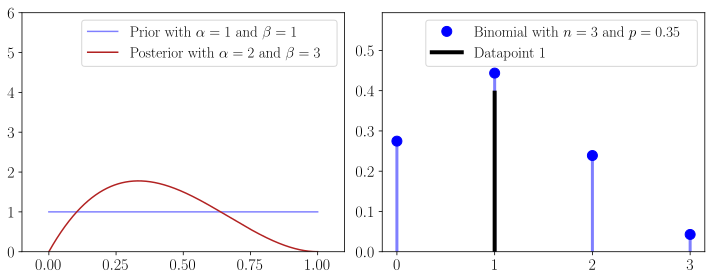

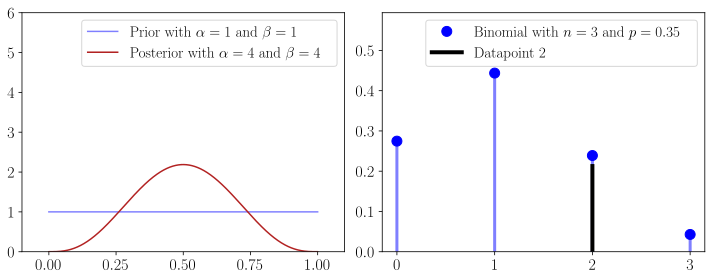

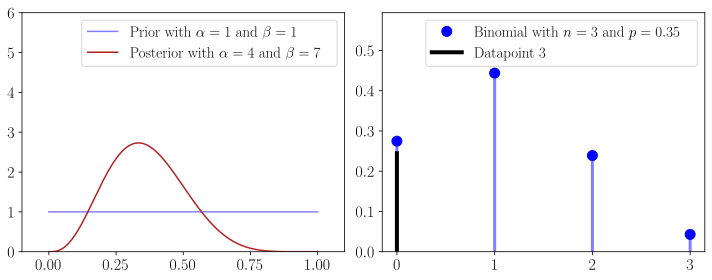

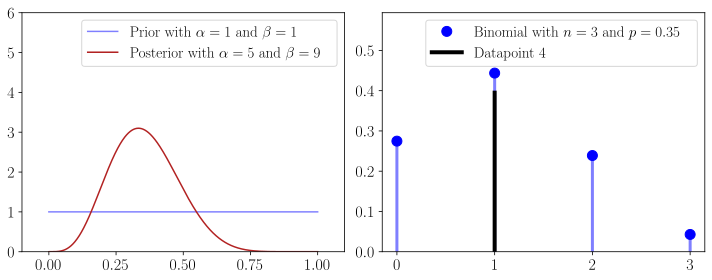

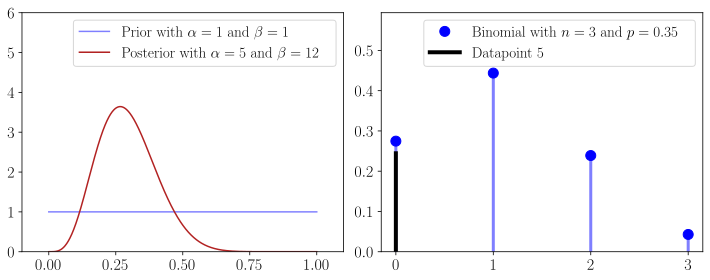

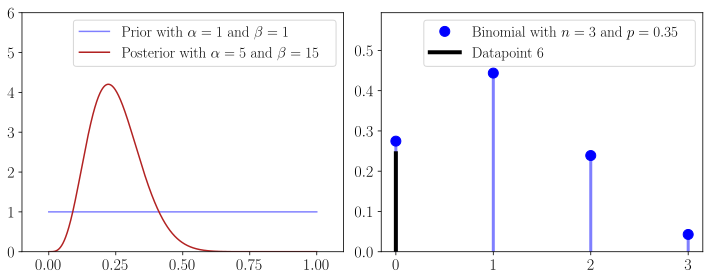

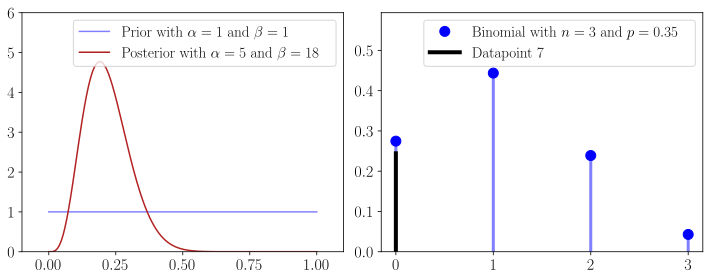

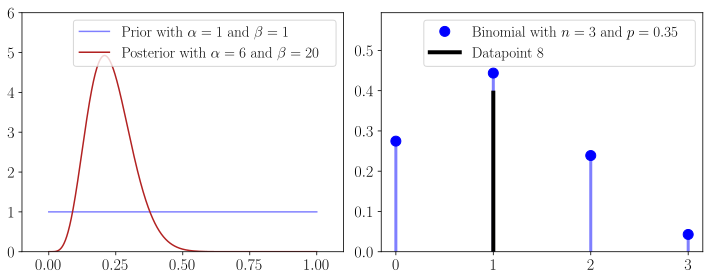

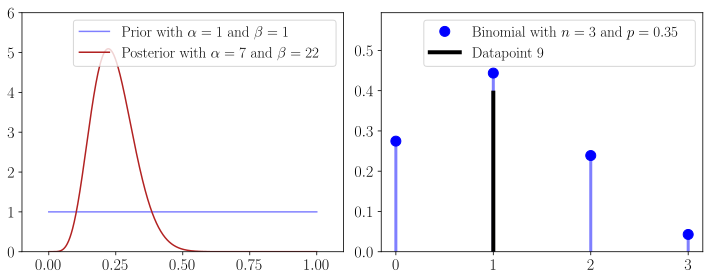

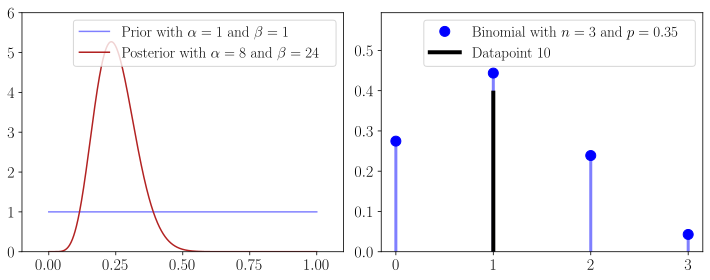

In [113]:
# show for 10 samples
np.random.seed(1)

a_current = a_prior
b_current = b_prior

for i in range(10):
    
    #draw a sample, i.e. flip the coin
    binom_sample = binom.rvs(n_binom, p_binom)
    
    #update parameters
    a_current += binom_sample 
    b_current += n_binom - binom_sample
        
    beta_current = beta.pdf(x_, a_current, b_current)
    
    fig, ax = plt.subplots(1, 2, figsize=(10, 4))
    ax[0].plot(x_, beta_prior, label=r'Prior with $\alpha={}$ and $\beta={}$'.format(a_prior, b_prior),
          color='blue', alpha=0.5)
    ax[0].plot(x_, beta_current, label=r'Posterior with $\alpha={}$ and $\beta={}$'.format(a_current, b_current),
              color='firebrick', alpha=1)
    ax[0].set_ylim(0, 6)
    ax[0].set_xlim(-0.1, 1.1)
    ax[0].legend(loc='upper right', prop={'size': legend_size})

    ax[1].plot(x_binom, binom_pmf, '.', label=r'Binomial with $n= {}$ and $p={}$'.format(n_binom, p_binom),
              marker='o', markersize=10, color='blue')
    ax[1].axvline(binom_sample, 0, binom.pmf(binom_sample, n_binom, p_binom)*1.5,
                  color='black', lw=4, label='Datapoint {}'.format(i+1))
    ax[1].set_ylim(0, binom_pmf.max() + 0.15)
    ax[1].vlines(x_binom, 0, binom_pmf, colors='b', lw=3, alpha=0.5)
    ax[1].legend(loc='upper right', prop={'size': legend_size})

    plt.rc('xtick', labelsize=16)
    plt.rc('ytick', labelsize=16)
    plt.rc('axes', labelsize=16)
    plt.tight_layout()

    plt.savefig('beta_{}_posterior_binomial.png'.format(i+1))
    plt.show();

## Mean of Normal with known variance

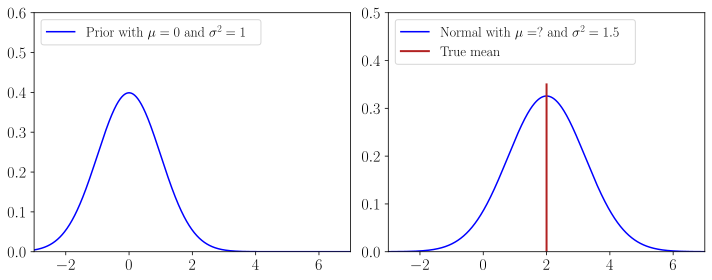

In [179]:
from scipy.stats import norm

m_prior = 0
v_prior = 1

m_likelihood = 2
v_likelihood = 1.5

legend_size = 14

x_ = np.linspace(-3,7, 1000+1)
norm_prior = norm.pdf(x_, m_prior, np.sqrt(v_prior))

x_likelihood = np.linspace(-3, 7, 1000+1)
norm_likelihood = norm.pdf(x_likelihood, m_likelihood, np.sqrt(v_likelihood))

fig, ax = plt.subplots(1, 2, figsize=(10, 4))
ax[0].plot(x_, norm_prior, label=r'Prior with $\mu={}$ and $\sigma^2={}$'.format(m_prior, v_prior),
          color='blue')
ax[0].set_ylim(0, 0.6)
ax[0].set_xlim(-3, 7)
ax[0].legend(loc='upper left', prop={'size': legend_size})

ax[1].plot(x_likelihood, norm_likelihood, label=r'Normal with $\mu=?$ and $\sigma^2={}$'.format(v_likelihood),
          color='blue')
ax[1].axvline(m_likelihood, 0, 0.7, color='firebrick', label='True mean', lw=2)
ax[1].set_xlim(-3,7)
ax[1].set_ylim(0, 0.5)
ax[1].legend(loc='upper left', prop={'size': legend_size})

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)
plt.rc('axes', labelsize=16)
plt.tight_layout()

plt.savefig('Normal_0_prior.png')
plt.show();

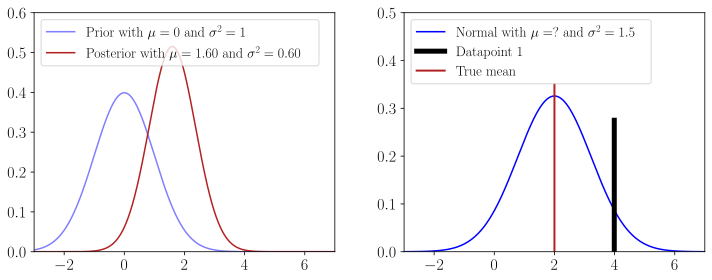

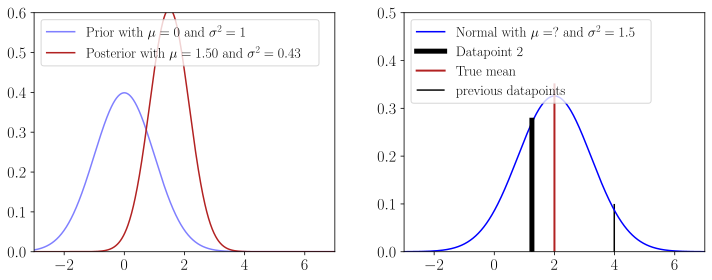

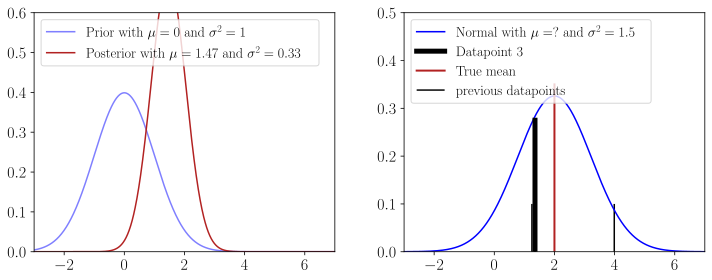

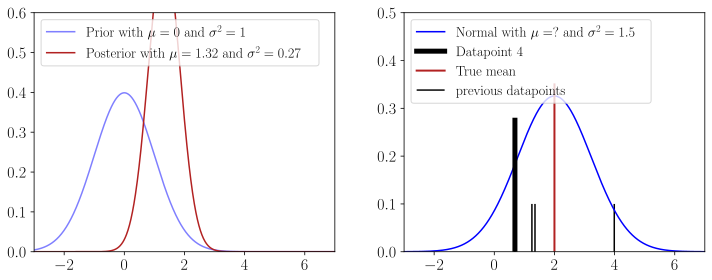

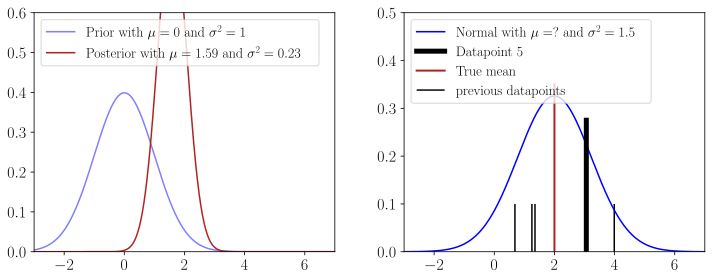

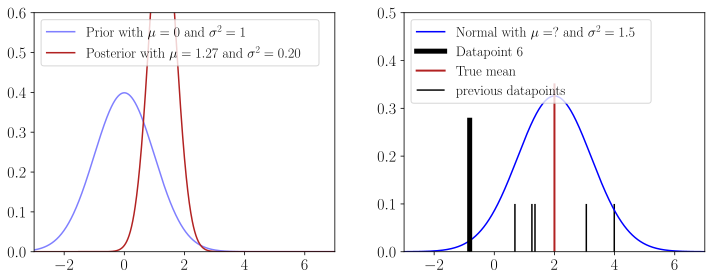

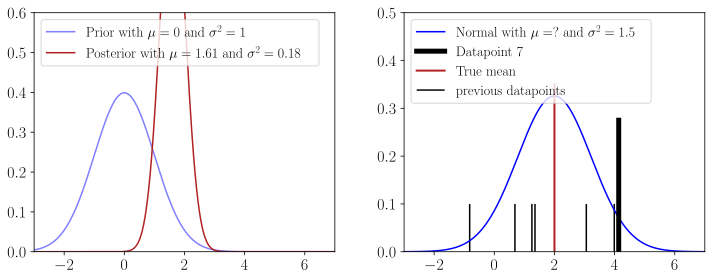

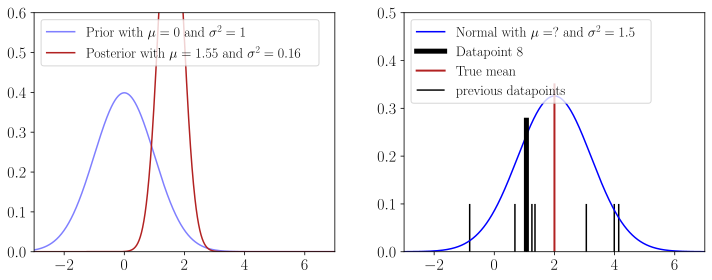

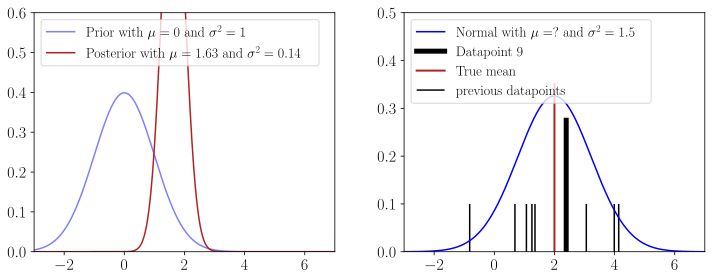

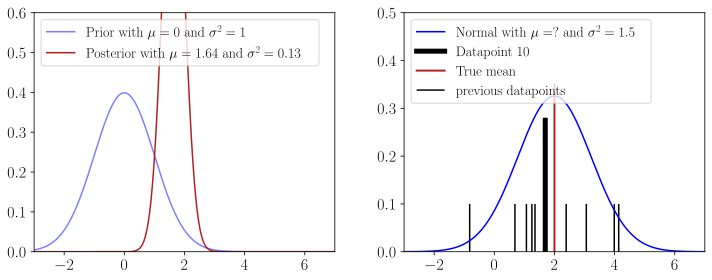

In [180]:
## update with samples drawn from the likelihood
np.random.seed(1)
    
def update_v(var0, var, n=1):
    return(1/(1/var0 + n/var))

def update_m(x, mu0, var0, var, n=1):
    new_v = update_v(var0, var, n)
    m_ = (mu0/var0 + np.sum(x)/var)
    return(new_v * m_)

m_current = m_prior
v_current = v_prior

datapoints = []

for i in range(10):
    
    #draw sample from likelihood
    norm_sample = norm.rvs(m_likelihood, np.sqrt(v_likelihood))
    datapoints.append(norm_sample)
    
    #update parameters
    v_current = update_v(v_prior, v_likelihood, n=i+1)
    m_current = update_m(datapoints, m_prior, v_prior, v_likelihood, n=i+1)
    norm_posterior = norm.pdf(x_, m_current, np.sqrt(v_current))
    
    #plot the current states
    fig, ax = plt.subplots(1, 2, figsize=(10, 4))
    ax[0].plot(x_, norm_prior, label=r'Prior with $\mu={}$ and $\sigma^2={}$'.format(m_prior, v_prior),
              color='blue', alpha=0.5)
    ax[0].plot(x_, norm_posterior, label=r'Posterior with $\mu={:.02f}$ and $\sigma^2={:.02f}$'.format(m_current, v_current),
              color='firebrick')
    ax[0].set_ylim(0, 0.6)
    ax[0].set_xlim(-3, 7)
    ax[0].legend(loc='upper left', prop={'size': legend_size})

    ax[1].plot(x_likelihood, norm_likelihood, label=r'Normal with $\mu=?$ and $\sigma^2={}$'.format(v_likelihood),
              color='blue')
    ax[1].axvline(norm_sample, 0, 0.55, color='black', label='Datapoint {}'.format(i+1), lw=5)
    ax[1].axvline(m_likelihood, 0, 0.7, color='firebrick', label='True mean', lw=2)
    if i > 0:
        ax[1].vlines(datapoints, 0, 0.1, color='black', label='previous datapoints')
    ax[1].set_xlim(-3,7)
    ax[1].set_ylim(0, 0.5)
    ax[1].legend(loc='upper left', prop={'size': legend_size})

    plt.rc('xtick', labelsize=16)
    plt.rc('ytick', labelsize=16)
    plt.rc('axes', labelsize=16)
    plt.tight_layout()

    plt.savefig('Normal_{}_posterior.png'.format(i+1))
    plt.show();


## Gamma with Poisson likelihoods

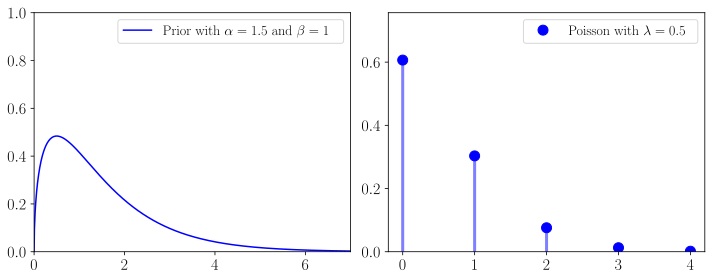

In [183]:
from scipy.stats import gamma, poisson 

l = 0.5

a_prior = 1.5
b_prior = 1

x_ = np.linspace(0,7, 1000+1)
gamma_prior = gamma.pdf(x_, a_prior, scale=1/b_prior)

x_poisson = np.arange(0, 5)
poisson_pmf = poisson.pmf(x_likelihood, l)

fig, ax = plt.subplots(1, 2, figsize=(10, 4))
ax[0].plot(x_, gamma_prior, label=r'Prior with $\alpha={}$ and $\beta={}$'.format(a_prior, b_prior),
          color='blue')
ax[0].set_ylim(0, 1)
ax[0].set_xlim(0, 7)
ax[0].legend(loc='upper right', prop={'size': legend_size})

ax[1].plot(x_poisson, poisson_pmf, '.', label=r'Poisson with $\lambda={}$'.format(l),
          marker='o', markersize=10, color='blue')
ax[1].set_ylim(0, poisson_pmf.max() + 0.15)
ax[1].vlines(x_likelihood, 0, poisson_pmf, colors='b', lw=3, alpha=0.5)
ax[1].legend(loc='upper right', prop={'size': legend_size})

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)
plt.rc('axes', labelsize=16)
plt.tight_layout()

plt.savefig('Gamma_0_prior_poisson.png')
plt.show();

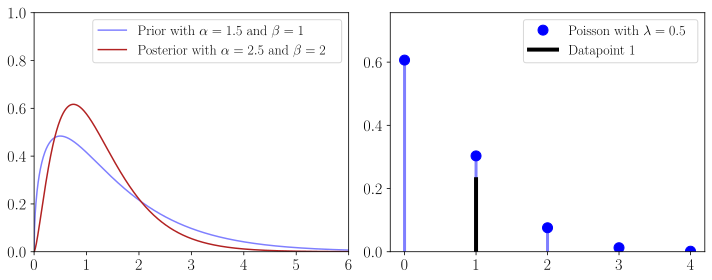

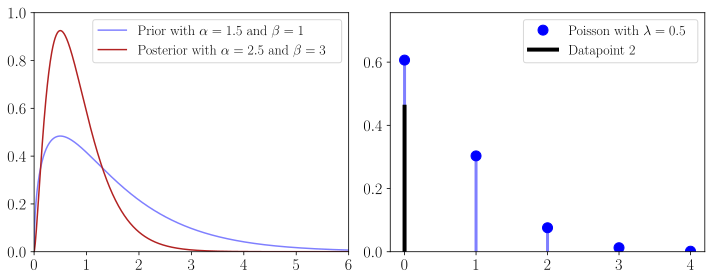

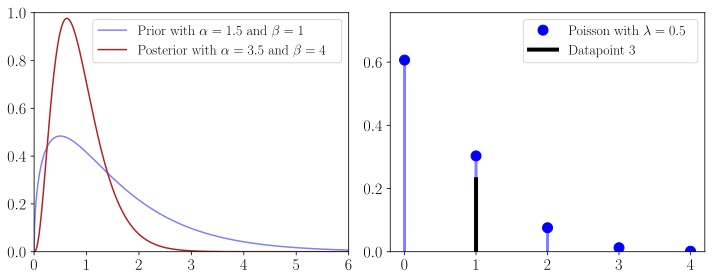

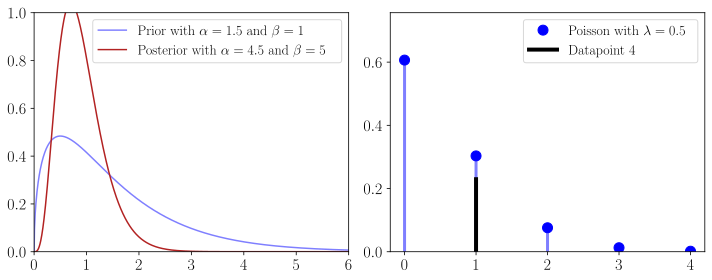

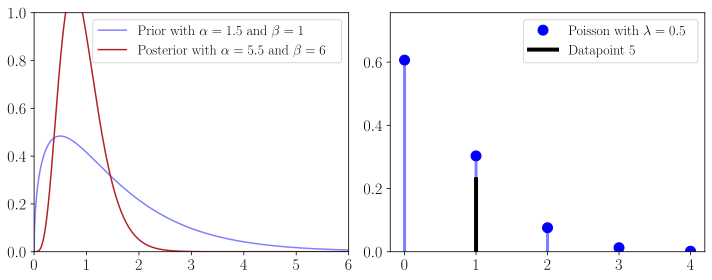

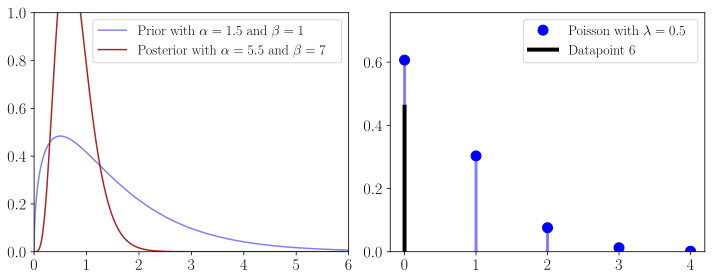

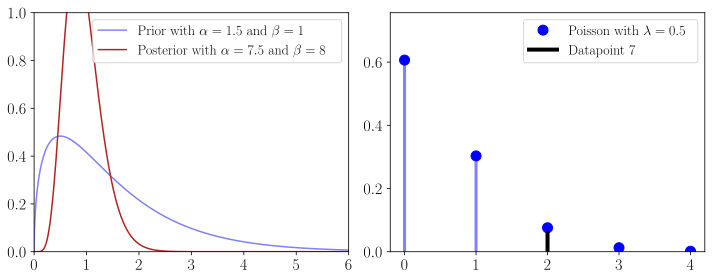

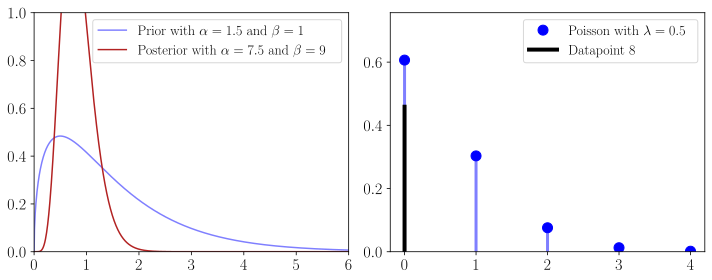

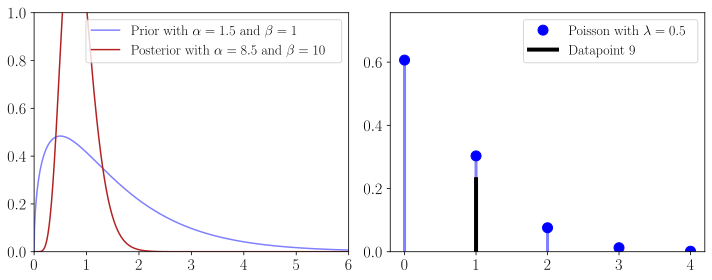

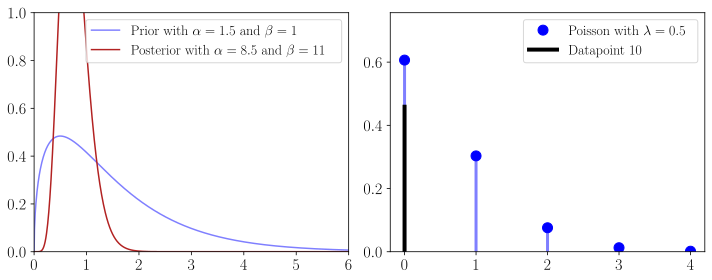

In [184]:
# update given samples

a_current = a_prior
b_current = b_prior

for i in range(10):
    
    
    #draw a poisson datapoint
    poisson_sample = poisson.rvs(l)
    
    #update parameters
    a_current += poisson_sample
    b_current += 1
    
    #plot it
    gamma_current = gamma.pdf(x_, a_current, scale=1/b_current)
    
    fig, ax = plt.subplots(1, 2, figsize=(10, 4))
    ax[0].plot(x_, gamma_prior, label=r'Prior with $\alpha={}$ and $\beta={}$'.format(a_prior, b_prior),
          color='blue', alpha=0.5)
    ax[0].plot(x_, gamma_current, label=r'Posterior with $\alpha={}$ and $\beta={}$'.format(a_current, b_current),
              color='firebrick', alpha=1)
    ax[0].set_ylim(0, 1)
    ax[0].set_xlim(0, 6)
    ax[0].legend(loc='upper right', prop={'size': legend_size})

    ax[1].plot(x_poisson, poisson_pmf, '.', label=r'Poisson with $\lambda={}$'.format(l),
          marker='o', markersize=10, color='blue')
    ax[1].axvline(poisson_sample, 0, poisson.pmf(poisson_sample, l)*1,
                  color='black', lw=4, label='Datapoint {}'.format(i+1))
    ax[1].set_ylim(0, poisson_pmf.max() + 0.15)
    ax[1].vlines(x_poisson, 0, poisson_pmf, colors='b', lw=3, alpha=0.5)
    ax[1].legend(loc='upper right', prop={'size': legend_size})

    plt.rc('xtick', labelsize=16)
    plt.rc('ytick', labelsize=16)
    plt.rc('axes', labelsize=16)
    plt.tight_layout()

    plt.savefig('Gamma_{}_posterior_poisson.png'.format(i+1))
    plt.show();

## Gamma with Exponential likelihoods

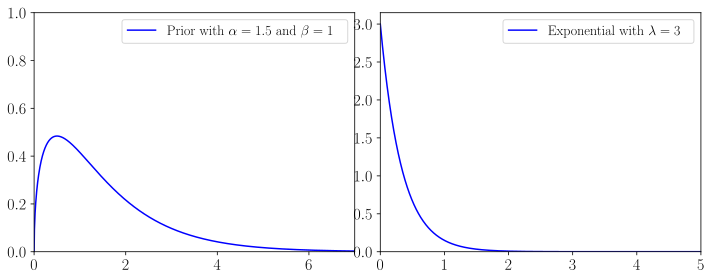

In [190]:
from scipy.stats import gamma, expon

l_poisson = 3

a_prior = 1.5
b_prior = 1

x_ = np.linspace(0,7, 1000+1)
gamma_prior = gamma.pdf(x_, a_prior, scale=1/b_prior)

x_exponential = np.linspace(0, 5, 1000+1)
exponential_pdf = expon.pdf(x_exponential, scale=1/l_poisson)

fig, ax = plt.subplots(1, 2, figsize=(10, 4))
ax[0].plot(x_, gamma_prior, label=r'Prior with $\alpha={}$ and $\beta={}$'.format(a_prior, b_prior),
          color='blue')
ax[0].set_ylim(0, 1)
ax[0].set_xlim(0, 7)
ax[0].legend(loc='upper right', prop={'size': legend_size})

ax[1].plot(x_exponential, exponential_pdf, label=r'Exponential with $\lambda={}$'.format(l),
          color='blue')
ax[1].set_ylim(0, exponential_pdf.max() + 0.15)
ax[1].set_xlim(0, 5)
ax[1].legend(loc='upper right', prop={'size': legend_size})

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)
plt.rc('axes', labelsize=16)
plt.tight_layout()

plt.savefig('Gamma_0_prior_exponential.png')
plt.show();

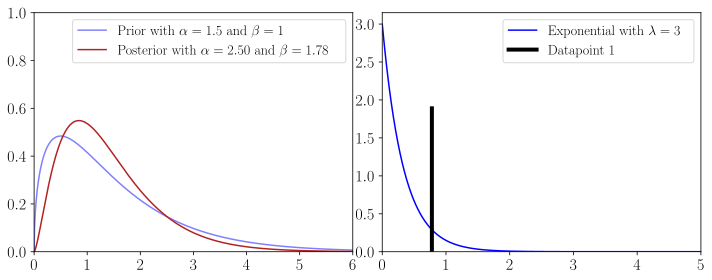

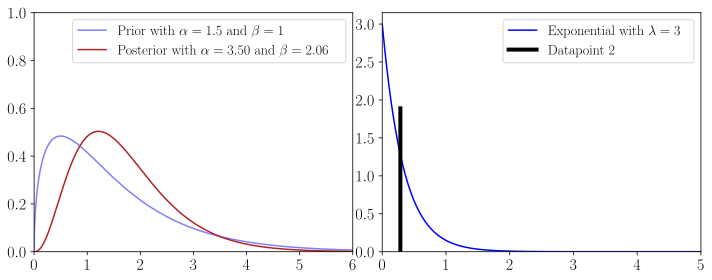

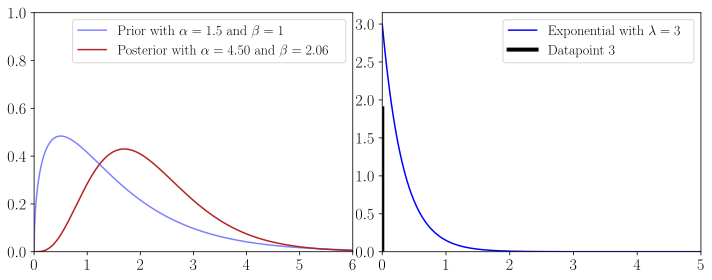

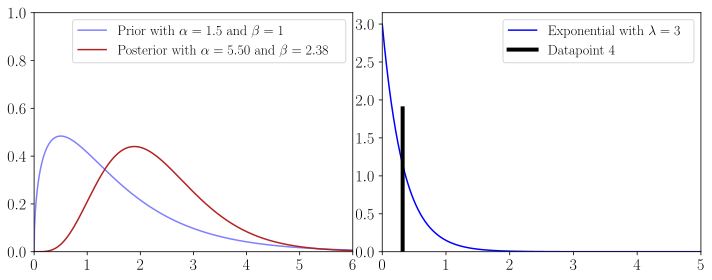

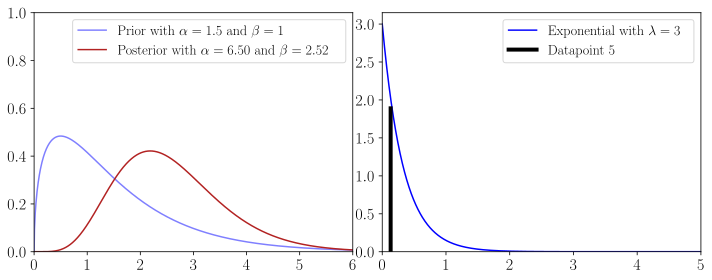

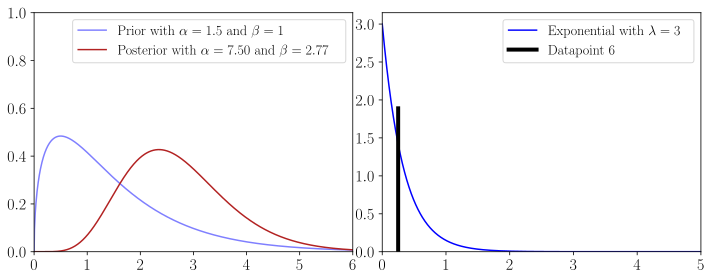

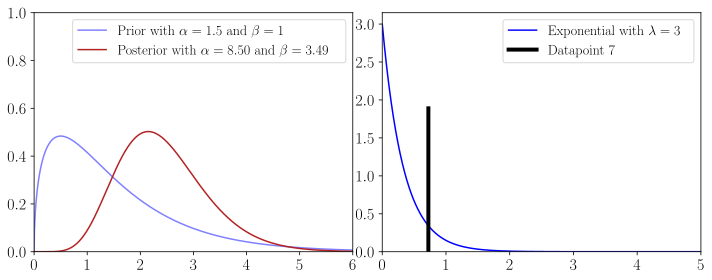

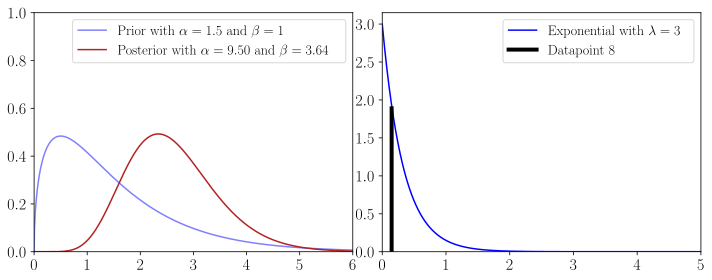

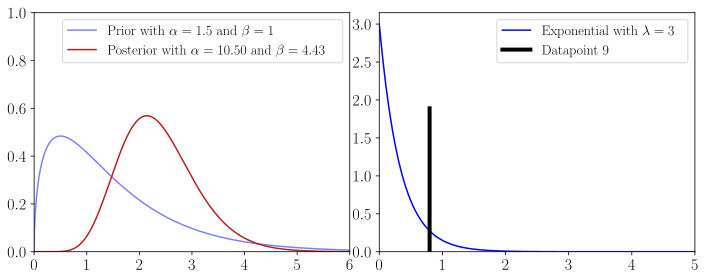

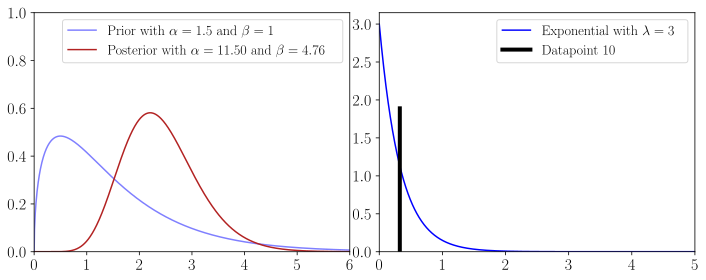

In [196]:
# update given samples

a_current = a_prior
b_current = b_prior

for i in range(10):
    
    
    #draw a poisson datapoint
    exponential_sample = expon.rvs(scale=1/l_poisson)
    
    #update parameters
    a_current += 1
    b_current += exponential_sample

    #plot it
    gamma_current = gamma.pdf(x_, a_current, scale=1/b_current)
    
    fig, ax = plt.subplots(1, 2, figsize=(10, 4))
    ax[0].plot(x_, gamma_prior, label=r'Prior with $\alpha={}$ and $\beta={}$'.format(a_prior, b_prior),
          color='blue', alpha=0.5)
    ax[0].plot(x_, gamma_current, label=r'Posterior with $\alpha={:.02f}$ and $\beta={:.02f}$'.format(a_current, b_current),
              color='firebrick', alpha=1)
    ax[0].set_ylim(0, 1)
    ax[0].set_xlim(0, 6)
    ax[0].legend(loc='upper right', prop={'size': legend_size})

    ax[1].plot(x_exponential, exponential_pdf, label=r'Exponential with $\lambda={}$'.format(l),
          color='blue')
    ax[1].axvline(exponential_sample, 0, 0.6,
                  color='black', lw=4, label='Datapoint {}'.format(i+1))
    ax[1].set_ylim(0, exponential_pdf.max() + 0.15)
    ax[1].set_xlim(0, 5)
    ax[1].legend(loc='upper right', prop={'size': legend_size})

    plt.rc('xtick', labelsize=16)
    plt.rc('ytick', labelsize=16)
    plt.rc('axes', labelsize=16)
    plt.tight_layout()

    plt.savefig('Gamma_{}_posterior_exponential.png'.format(i+1))
    plt.show();

## Dirichlet with multinomial likelihoods

561


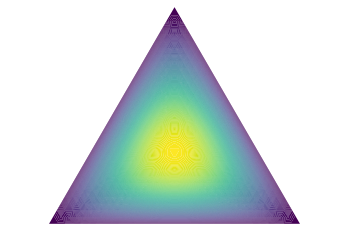

In [22]:
# plotting devices
from scipy.special import gammaln, xlogy
import matplotlib.tri as tri

corners = np.array([[0, 0], [1, 0], [0.5, 0.75**0.5]])
triangle = tri.Triangulation(corners[:, 0], corners[:, 1])

refiner = tri.UniformTriRefiner(triangle)
trimesh = refiner.refine_triangulation(subdiv=4)


midpoints = [(corners[(i + 1) % 3] + corners[(i + 2) % 3]) / 2.0 \
             for i in range(3)]
def xy2bc(xy, tol=1.e-3):
    '''Converts 2D Cartesian coordinates to barycentric.'''
    s = [(corners[i] - midpoints[i]).dot(xy - midpoints[i]) / 0.75 \
         for i in range(3)]
    return np.clip(s, tol, 1.0 - tol)

class Dirichlet(object):
    def __init__(self, alpha):
        self._alpha = np.array(alpha)
        self._coef = np.sum(gammaln(alpha)) - gammaln(np.sum(alpha))    
        
    def pdf(self, x):
        '''Returns pdf value for `x`.'''
        return(np.exp(- self._coef+ np.sum((xlogy(self._alpha-1, x.T)).T, 0)))
    
def draw_pdf_contours(dist, nlevels=200, subdiv=5, **kwargs):

    refiner = tri.UniformTriRefiner(triangle)
    trimesh = refiner.refine_triangulation(subdiv=subdiv)
    pvals = [dist.pdf(xy2bc(xy)) for xy in zip(trimesh.x, trimesh.y)]
    xys = [xy2bc(xy) for xy in zip(trimesh.x, trimesh.y)]
    print(len(xys))

    plt.tricontourf(trimesh, pvals, nlevels, **kwargs)
    plt.axis('equal')
    plt.xlim(0, 1)
    plt.ylim(0, 0.75**0.5)
    plt.axis('off')
    plt.show();
    
draw_pdf_contours(Dirichlet([2, 2, 2]))

561


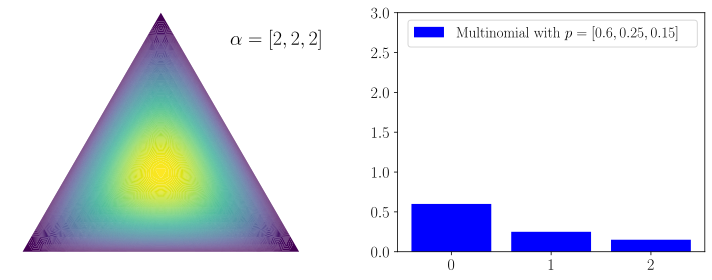

In [70]:
from scipy.stats import dirichlet, multinomial

multi_p = [0.6, 0.25, 0.15] 

a_prior = [2,2,2]

x_multi = np.arange(0,3)

fig, ax = plt.subplots(1, 2, figsize=(10, 4))

#Dirichlet
nlevels=200
subdiv=5
dist = Dirichlet(a_prior)
refiner = tri.UniformTriRefiner(triangle)
trimesh = refiner.refine_triangulation(subdiv=subdiv)
pvals = [dist.pdf(xy2bc(xy)) for xy in zip(trimesh.x, trimesh.y)]
xys = [xy2bc(xy) for xy in zip(trimesh.x, trimesh.y)]
print(len(xys))

ax[0].tricontourf(trimesh, pvals, nlevels)
ax[0].axis('equal')
ax[0].set_xlim(0, 1)
ax[0].set_ylim(0, 0.75**0.5)
ax[0].axis('off')
#ax[0].legend(loc='upper right', prop={'size': legend_size})
ax[0].text(0.75, 0.75, r'$\alpha={}$'.format(a_prior), fontsize=20)

ax[1].bar(x_multi, multi_p, label=r'Multinomial with $p={}$'.format(multi_p),
          color='blue')
ax[1].set_ylim(0, 3)
ax[1].legend(loc='upper right', prop={'size': legend_size})

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)
plt.rc('axes', labelsize=16)
plt.tight_layout()

plt.savefig('Dirichlet_0_prior_multinomial.png')
plt.show();

561


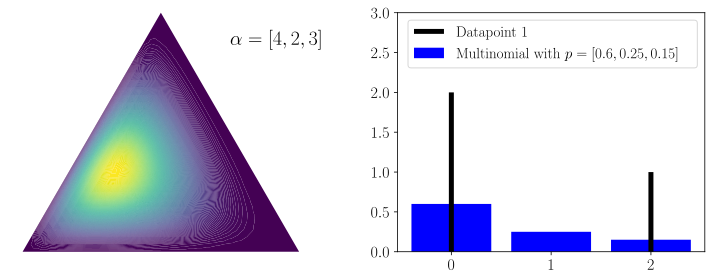

561


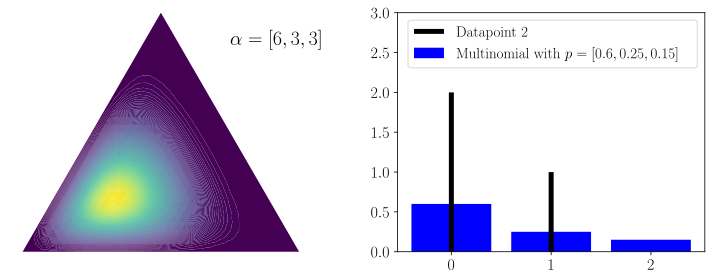

561


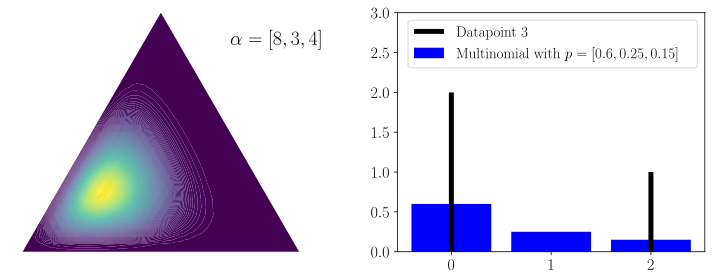

561


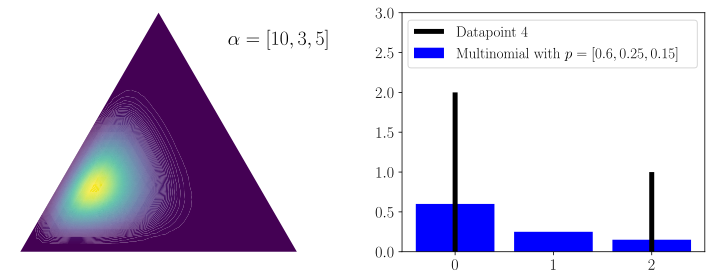

561


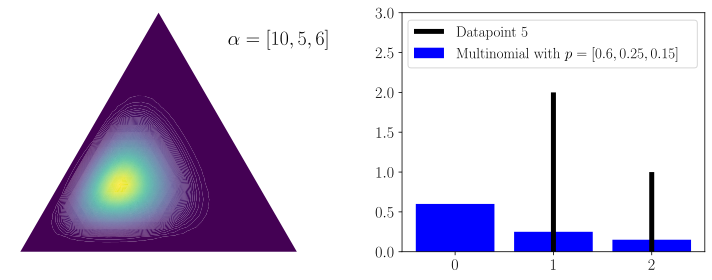

561


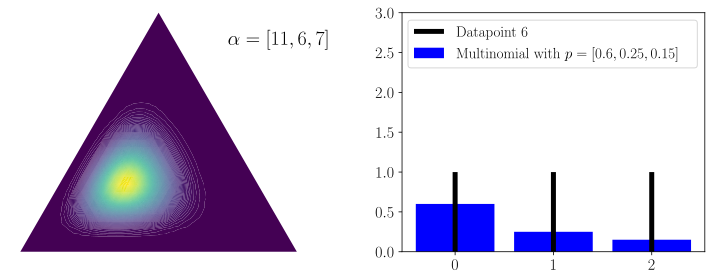

561


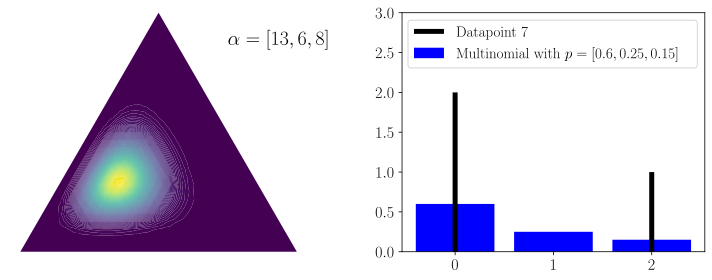

561


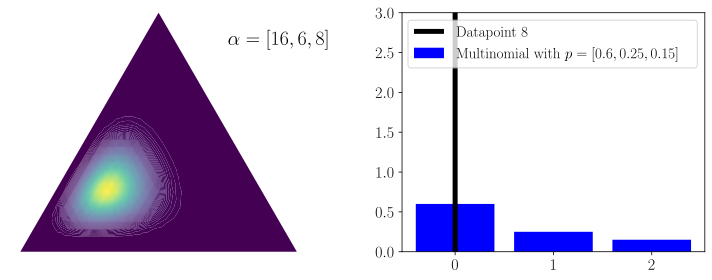

561


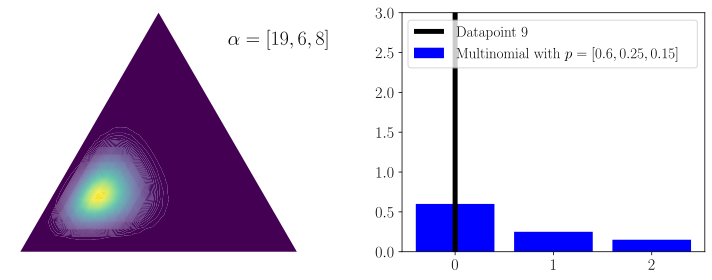

561


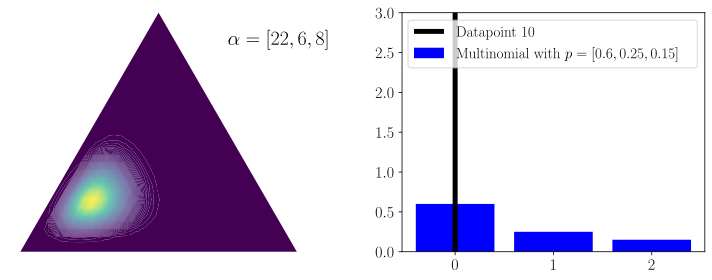

In [69]:
# create some updates
np.random.seed(0)
a_current = np.array(a_prior)


# draw samples
for i in range(10):

    multi_sample = multinomial.rvs(3, multi_p)
    a_current += multi_sample
    a_current = list(a_current)
    
    fig, ax = plt.subplots(1, 2, figsize=(10, 4))

    #Dirichlet
    nlevels=200
    subdiv=5
    dist = Dirichlet(a_current)
    refiner = tri.UniformTriRefiner(triangle)
    trimesh = refiner.refine_triangulation(subdiv=subdiv)
    pvals = [dist.pdf(xy2bc(xy)) for xy in zip(trimesh.x, trimesh.y)]
    xys = [xy2bc(xy) for xy in zip(trimesh.x, trimesh.y)]
    print(len(xys))

    ax[0].tricontourf(trimesh, pvals, nlevels)
    ax[0].axis('equal')
    ax[0].set_xlim(0, 1)
    ax[0].set_ylim(0, 0.75**0.5)
    ax[0].axis('off')
    #ax[0].legend(loc='upper right', prop={'size': legend_size})
    ax[0].text(0.75, 0.75, r'$\alpha={}$'.format(a_current), fontsize=20)

    ax[1].bar(x_multi, multi_p, label=r'Multinomial with $p={}$'.format(multi_p),
              color='blue')
    ax[1].vlines(x_multi, 0, multi_sample, color='black', label='Datapoint {}'.format(i+1),
                lw=5)
    ax[1].set_ylim(0, 3)
    ax[1].legend(loc='upper right', prop={'size': legend_size})

    plt.rc('xtick', labelsize=16)
    plt.rc('ytick', labelsize=16)
    plt.rc('axes', labelsize=16)
    plt.tight_layout()

    plt.savefig('Dirichlet_{}_prior_multinomial.png'.format(i+1))
    plt.show();

## Inverse Wishart Distribution

In [3]:
#TODO: how to visualize the Wishart properly?
# if we use a 2D Wishart we can do
# 1. marginals
# 2. scatter plots for all 3 entries
# 3. see this paper in general: http://www.stat.columbia.edu/~gelman/research/unpublished/Visualization.pdf

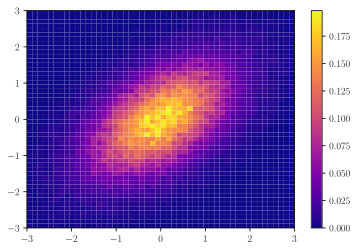

In [72]:
# set up inverse Wishart prior
from scipy.stats import invwishart
from scipy.stats import multivariate_normal as mv_norm

nu_0 = 3
Psi_0 = np.eye(2)

mu_0 = np.zeros(2)
Sigma_0 = np.array([[1,0.5], [0.5,1]])


X = mv_norm.rvs(mu_0, Sigma_0, size=100000)
x_G = X[:,0]
y_G = X[:,1]

#create plots for the Gaussian likelihood
"""
import scipy.stats as st

xmin, xmax = -3, 3
ymin, ymax = -3, 3
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]

positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([x, y])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)

fig = plt.figure(figsize=(13, 7))
ax = plt.axes(projection='3d')
surf = ax.plot_surface(xx, yy, f, rstride=1, cstride=1, cmap='coolwarm', edgecolor='none')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('PDF')
ax.set_title('Surface plot of a Gaussian')
fig.colorbar(surf, shrink=0.5, aspect=5) # add color bar indicating the PDF
ax.view_init(40, 20)
"""

h = plt.hist2d(x_G, y_G, range=[[-3,3],[-3,3]],bins=[50,50], cmap='plasma', density = True)
#plt.plot(0,0,'ro', color='black') 
plt.colorbar(h[3]);

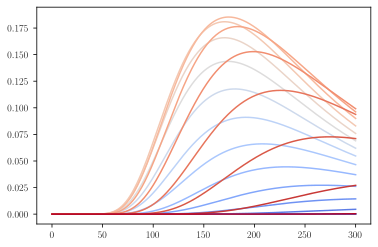

In [87]:
# create plots for the wishart
from scipy.special import gamma
from matplotlib import cm

####### 1 start with marginals
def is_pos_def(x):
    eig = np.linalg.eigvals(x)
    pd = np.all(eig > 0)
    if not pd:
        raise(ValueError("Psi matrix is not positive definite! Matrix: {}; Eigenvalues: {}".format(x, eig)))
    else:
        return(True)

def multi_variate_gamma(p, a):
    a = np.pi**(p*(p-1)/4) 
    b = np.prod([gamma(a + (1-j)/2) for j in range(1, p + 1)])
    return(a*b)

def inverse_wishart_pdf(X, v, Psi):
    p = np.shape(X)[0]
    const = np.linalg.det(Psi)**(v/2)/(2**(v*p/2) * multi_variate_gamma(p, v/2))
    rest = np.linalg.det(X)**(-(v+p+1)/2) * np.exp(-1/2*np.trace(Psi @ np.linalg.inv(X)))
    return(const * rest)

def make_2D_psd_cone_cut(a_11, a_22, rho):
    xx = []
    
    for i in range(len(a_11)):
        a_12 = rho*np.sqrt(a_11[i] * a_22[i])
        matrix = np.array([[a_11[i], a_12],[a_12, a_22[i]]])
        is_pos_def(matrix)
        xx.append(matrix)
        
    return(xx)

a_11 = np.linspace(0.01, 1, 300 +1)
a_22 = np.linspace(0.01, 1, 300 +1)
r = 0.9
xx = make_2D_psd_cone_cut(a_11, a_22, r)

marginals = []
rhos = np.linspace(-0.9, 0.9, 19)

Psi_test= np.array([[5, 1], [1, 2]])

for r_ in rhos:

    inv_wishart_marginal = []
    xx = make_2D_psd_cone_cut(a_11, a_22, r_)
    for x in xx:
        v = inverse_wishart_pdf(x, nu_0, Psi_test)
        inv_wishart_marginal.append(v)
        
    marginals.append(inv_wishart_marginal)
    

evenly_spaced_interval = np.linspace(0, 1, len(rhos))
colors = [cm.coolwarm(x) for x in evenly_spaced_interval]
    
for i, m in enumerate(marginals):
    plt.plot(m, color=colors[i])
    
plt.show();

/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in log
  if __name__ == '__main__':
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


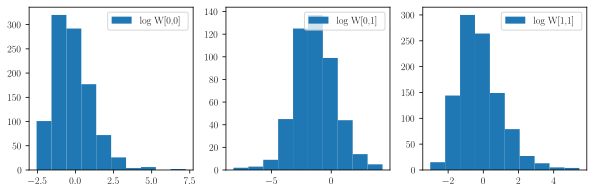

In [9]:
##### 2. draw samples of the Wishart and make histograms of the entries

inv_wishart_samples = invwishart.rvs(nu_0, Psi_0, size=1000)
inv_wishart_samples_00 = inv_wishart_samples[:,0,0]
inv_wishart_samples_01 = inv_wishart_samples[:,0,1]
inv_wishart_samples_11 = inv_wishart_samples[:,1,1]

inv_wishart_samples_00_log = np.log(inv_wishart_samples_00)
inv_wishart_samples_01_log = np.log(inv_wishart_samples_01)
inv_wishart_samples_11_log = np.log(inv_wishart_samples_11)

fig, ax = plt.subplots(1, 3, figsize=(10,3))

ax[0].hist(inv_wishart_samples_00_log, label='log W[0,0]')
ax[0].legend(loc='upper right')
ax[1].hist(inv_wishart_samples_01_log, label='log W[0,1]')
ax[1].legend(loc='upper right')
ax[2].hist(inv_wishart_samples_11_log, label='log W[1,1]')
ax[2].legend(loc='upper right')



plt.show();

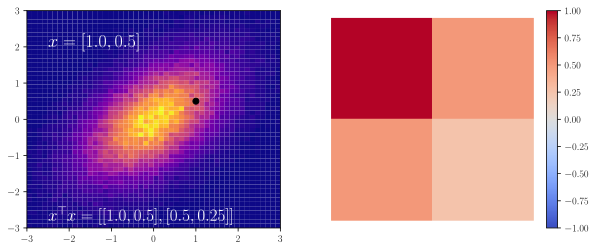

In [98]:
## create plots for Gaussian likelihood

def plot_Gaussian_likelihood(G_sample):
    
    outer_product = np.outer(G_sample, G_sample)
    v_max = np.max(np.abs(outer_product))
    v_min = -v_max
    outer_product_list = [list(l) for l in outer_product]
    outer_product_list_formatted = [float('%.2f' % elem) for l in outer_product_list for elem in l]
    outer_product_list_formatted = [[outer_product_list_formatted[0], outer_product_list_formatted[1]],
                                    [outer_product_list_formatted[2], outer_product_list_formatted[3]]]
    #TODO reshape
    #x for b in a for x in b
    
    G_sample_formatted = [float('%.2f' % elem) for elem in G_sample]
    
    #plot
    fig, ax = plt.subplots(1, 2, figsize=(10, 4))
    h = ax[0].hist2d(x_G, y_G, range=[[-3,3],[-3,3]],bins=[50,50], cmap='plasma', density = True)
    ax[0].plot(G_sample[0], G_sample[1],'ro', color='black') 
    ax[0].text(-2.5, 2, r'$x={}$'.format(G_sample_formatted), size=18, color='white')
    ax[0].text(-2.5, -2.8, r'$x^\top x={}$'.format(outer_product_list_formatted), size=17, color='white')
    
    h2 = ax[1].imshow(outer_product, cmap='coolwarm', vmin=v_min, vmax=v_max)
    ax[1].axis('off')
    #ax[1].colobar(h2[3])
    fig.colorbar(h2, ax=ax[1])

plot_Gaussian_likelihood([1,0.5])

/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:34: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


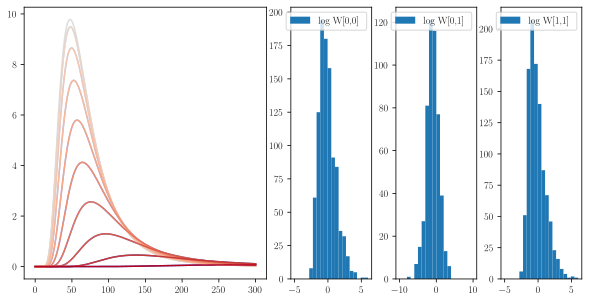

In [92]:
### make plots for the Wishart parameters

def plot_Wishart(nu, Psi, range1, range2, range3):

    #compute values
    #for first plot
    a_11 = np.linspace(0.01, 2, 300 +1)
    a_22 = np.linspace(0.01, 2, 300 +1)

    marginals = []
    rhos = np.linspace(-0.9, 0.9, 19)

    for r_ in rhos:

        inv_wishart_marginal = []
        xx = make_2D_psd_cone_cut(a_11, a_22, r_)
        for x in xx:
            v = inverse_wishart_pdf(x, nu, Psi)
            inv_wishart_marginal.append(v)

        marginals.append(inv_wishart_marginal)


    evenly_spaced_interval = np.linspace(0, 1, len(rhos))
    colors = [cm.coolwarm(x) for x in evenly_spaced_interval]
    
    #for second plot
    inv_wishart_samples = invwishart.rvs(nu, Psi, size=1000)
    inv_wishart_samples_00 = inv_wishart_samples[:,0,0]
    inv_wishart_samples_01 = inv_wishart_samples[:,0,1]
    inv_wishart_samples_11 = inv_wishart_samples[:,1,1]

    inv_wishart_samples_00_log = np.log(inv_wishart_samples_00)
    inv_wishart_samples_01_log = np.log(inv_wishart_samples_01)
    inv_wishart_samples_11_log = np.log(inv_wishart_samples_11)
    
    #plot them
    fig, ax = plt.subplots(1, 4, gridspec_kw={'width_ratios': [3, 1,1,1]}, figsize=(10, 5))
    for i, m in enumerate(marginals):
        ax[0].plot(m, color=colors[i])
        

    ax[1].hist(inv_wishart_samples_00_log, label='log W[0,0]', bins=20, range=range1)
    ax[1].legend(loc='upper right')
    ax[2].hist(inv_wishart_samples_01_log, label='log W[0,1]', bins=20, range=range2)
    ax[2].legend(loc='upper right')
    ax[3].hist(inv_wishart_samples_11_log, label='log W[1,1]', bins=20, range=range3)
    ax[3].legend(loc='upper right')
        
    plt.show();
    
plot_Wishart(nu_0, Psi_0, [-5, 6], [-10, 10], [-5, 6])

/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


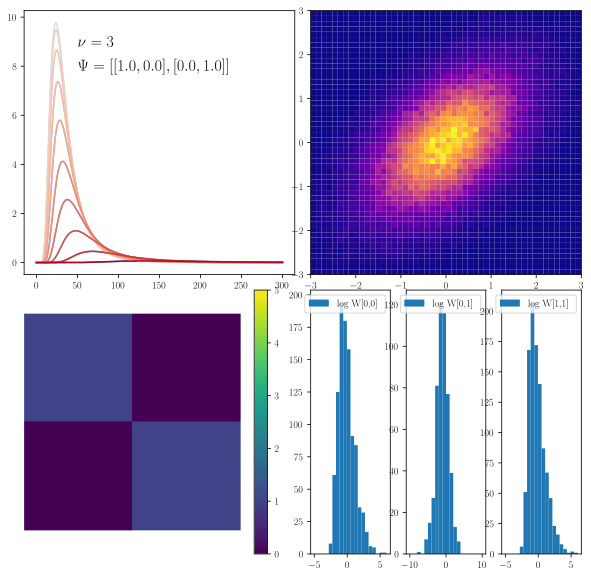

In [109]:
## plot everything related to the Wishart in one big plot
import matplotlib.gridspec as gridspec

def plot_Wishart_all(nu, Psi, G_sample, range1, range2, range3, v_max, filename, prior=False):
    
    #compute all relevant values
    # Wishart marginals
    a_11 = np.linspace(0.01, 2, 300 +1)
    a_22 = np.linspace(0.01, 2, 300 +1)

    marginals = []
    rhos = np.linspace(-0.9, 0.9, 19)

    for r_ in rhos:

        inv_wishart_marginal = []
        xx = make_2D_psd_cone_cut(a_11, a_22, r_)
        for x in xx:
            v = inverse_wishart_pdf(x, nu, Psi)
            inv_wishart_marginal.append(v)

        marginals.append(inv_wishart_marginal)


    evenly_spaced_interval = np.linspace(0, 1, len(rhos))
    colors = [cm.coolwarm(x) for x in evenly_spaced_interval]
    
    #prep numbers for picture
    Psi_list = [list(l) for l in Psi]
    Psi_list_formatted = [float('%.2f' % elem) for l in Psi_list for elem in l]
    Psi_list_formatted = [[Psi_list_formatted[0], Psi_list_formatted[1]],
                          [Psi_list_formatted[2], Psi_list_formatted[3]]]
    
    #for Wishart histogram
    inv_wishart_samples = invwishart.rvs(nu, Psi, size=1000)
    inv_wishart_samples_00 = inv_wishart_samples[:,0,0]
    inv_wishart_samples_01 = inv_wishart_samples[:,0,1]
    inv_wishart_samples_11 = inv_wishart_samples[:,1,1]

    inv_wishart_samples_00_log = np.log(inv_wishart_samples_00)
    inv_wishart_samples_01_log = np.log(inv_wishart_samples_01)
    inv_wishart_samples_11_log = np.log(inv_wishart_samples_11)
    
    #Gaussian likelihood
    outer_product = np.outer(G_sample, G_sample)
    outer_product_list = [list(l) for l in outer_product]
    outer_product_list_formatted = [float('%.2f' % elem) for l in outer_product_list for elem in l]
    outer_product_list_formatted = [[outer_product_list_formatted[0], outer_product_list_formatted[1]],
                                    [outer_product_list_formatted[2], outer_product_list_formatted[3]]]
    #TODO reshape
    #x for b in a for x in b
    
    G_sample_formatted = [float('%.2f' % elem) for elem in G_sample]
    
    # plot everything
    fig = plt.figure(1, figsize=(10,10))
    # set up subplot grid
    gridspec.GridSpec(6,6)
    
    # top left: Wishart marginals
    plt.subplot2grid((6,6), (0,0), colspan=3, rowspan=3)
    for i, m in enumerate(marginals):
        plt.plot(m, color=colors[i])
    mm = np.max(marginals)
    plt.text(50, 9/10*mm, r'$\nu={}$'.format(nu), size=16)
    plt.text(50, 8/10*mm, r'$\Psi={}$'.format(Psi_list_formatted),size=16)
    
    
    # top right: Gaussian sample
    plt.subplot2grid((6,6), (0,3), colspan=3, rowspan=3)
    plt.hist2d(x_G, y_G, range=[[-3,3],[-3,3]],bins=[50,50], cmap='plasma', density = True)
    if not prior:
        plt.plot(G_sample[0], G_sample[1],'ro', color='black') 
        plt.text(-2.5, 2, r'$x={}$'.format(G_sample_formatted), size=18, color='white')
        plt.text(-2.5, -2.8, r'$x^\top x={}$'.format(outer_product_list_formatted), size=17, color='white')

    # Bottom left: heatmap of current Psi
    plt.subplot2grid((6,6), (3,0), colspan=3, rowspan=3)
    h = plt.imshow(Psi, vmin=0, vmax=v_max, cmap='viridis')
    plt.axis('off')
    plt.colorbar(h)
    
    # bottom right: histograms of log Wishart values
    plt.subplot2grid((6,6), (3,3), colspan=1, rowspan=3)
    plt.hist(inv_wishart_samples_00_log, label='log W[0,0]', bins=20, range=range1)
    plt.legend(loc='upper right')
    
    plt.subplot2grid((6,6), (3,4), colspan=1, rowspan=3)
    plt.hist(inv_wishart_samples_01_log, label='log W[0,1]', bins=20, range=range2)
    plt.legend(loc='upper right')
    
    plt.subplot2grid((6,6), (3,5), colspan=1, rowspan=3)
    plt.hist(inv_wishart_samples_11_log, label='log W[1,1]', bins=20, range=range3)
    plt.legend(loc='upper right')
    
    plt.savefig(filename)
    plt.show();
    
plot_Wishart_all(nu=nu_0, Psi=Psi_0, G_sample=[1,0.5], range1=[-5,6], range2=[-10,10], 
                 range3=[-5, 6], v_max=5, prior=True, filename='Wishart_0_prior_Gaussian.png')

current nu:  4
current Psi:  [[1.13034622 0.18026446]
 [0.18026446 1.24929972]]


/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


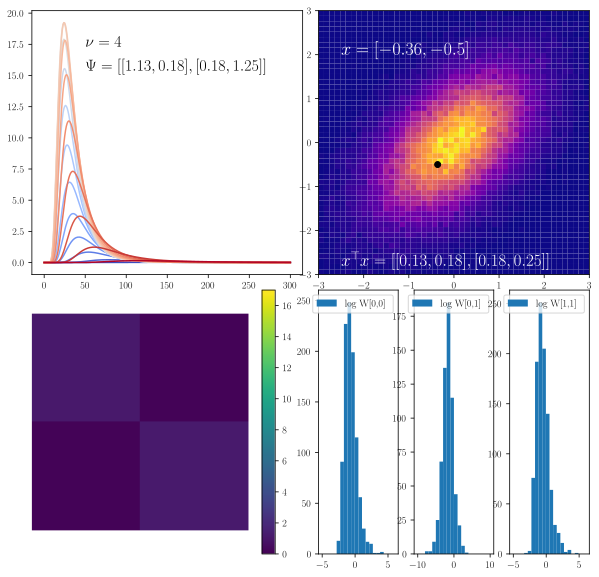

current nu:  5
current Psi:  [[2.48642148 0.42998465]
 [0.42998465 1.29528549]]


/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


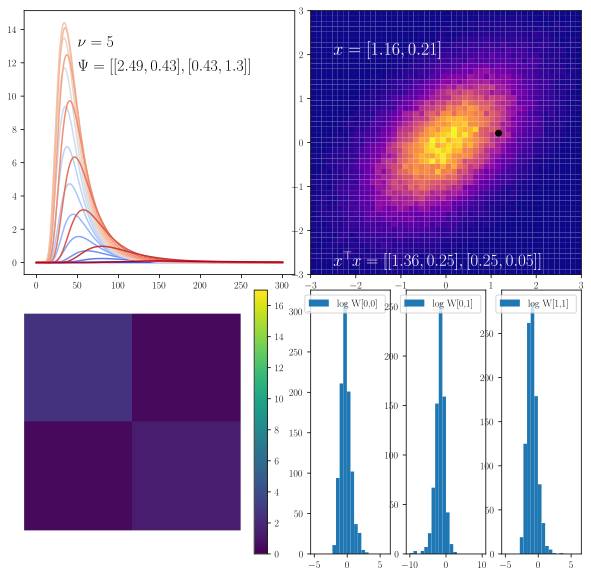

current nu:  6
current Psi:  [[2.48744205 0.42467106]
 [0.42467106 1.32295059]]


/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


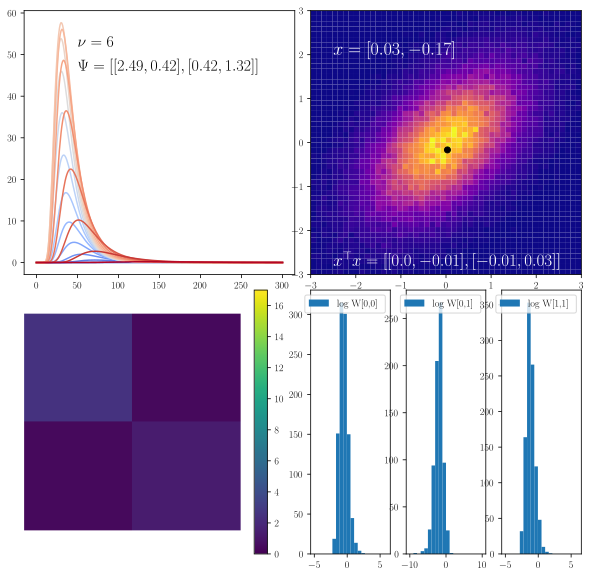

current nu:  7
current Psi:  [[2.63864735 0.41546508]
 [0.41546508 1.32351109]]


/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


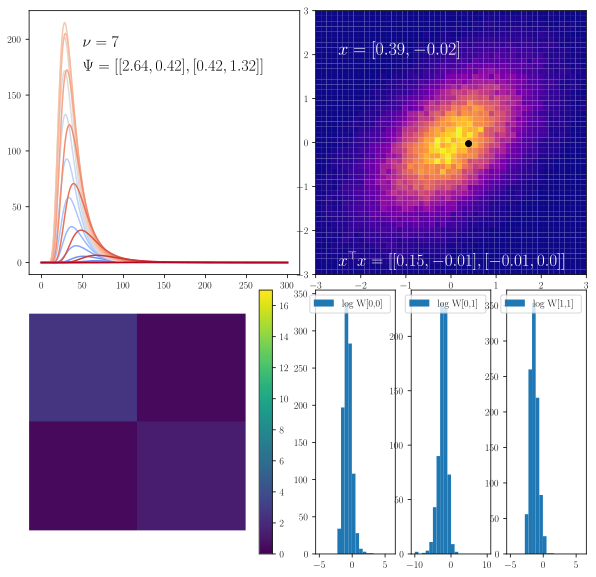

current nu:  8
current Psi:  [[2.76528874 0.37075812]
 [0.37075812 1.33929354]]


/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


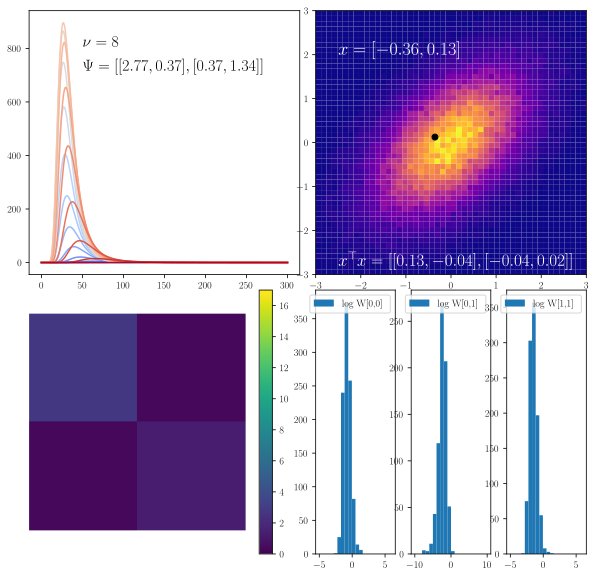

current nu:  9
current Psi:  [[2.97330652 0.84636102]
 [0.84636102 2.42669149]]


/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


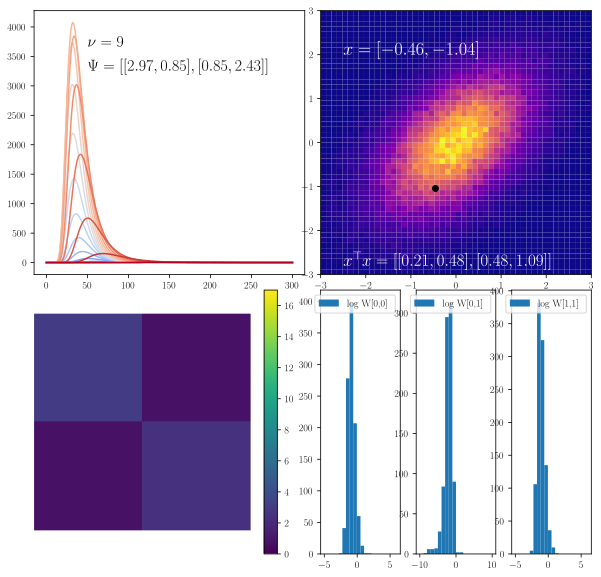

current nu:  10
current Psi:  [[ 6.22933777  5.96058252]
 [ 5.96058252 10.45955714]]


/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


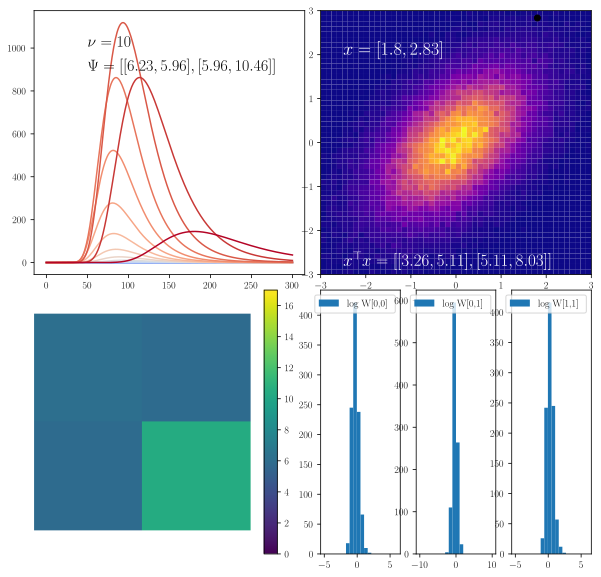

current nu:  11
current Psi:  [[ 6.87763675  4.90642011]
 [ 4.90642011 12.1736712 ]]


/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


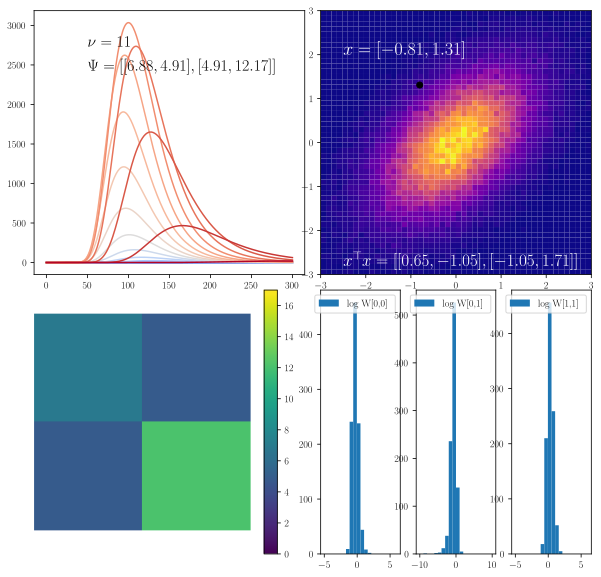

current nu:  12
current Psi:  [[ 8.5030129   7.37534024]
 [ 7.37534024 15.92392102]]


/home/marius/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/marius/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


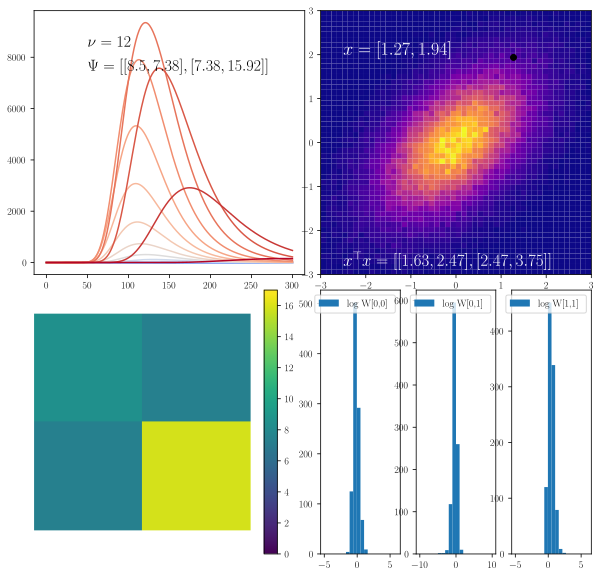

current nu:  13
current Psi:  [[ 8.74239594  7.87090618]
 [ 7.87090618 16.94983162]]


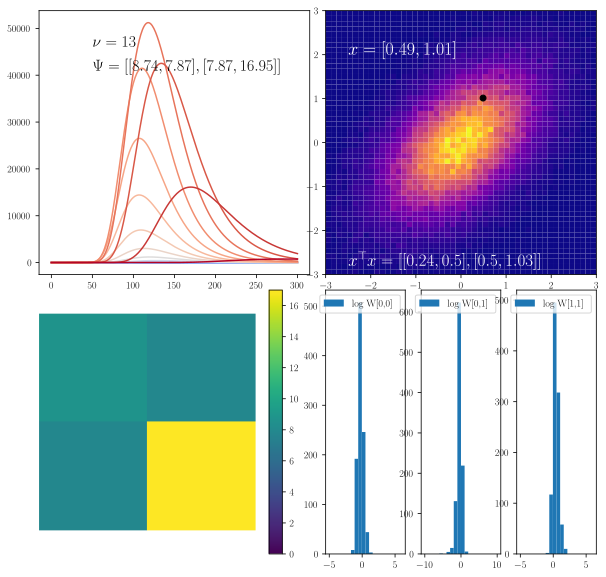

In [110]:
######## draw samples and update figures
import copy

np.random.seed(42)

current_nu = copy.copy(nu_0)
current_Psi = copy.copy(Psi_0)

for i in range(10):
    
    # draw a sample from the Gaussian
    G_sample = mv_norm.rvs(mu_0, Sigma_0)
    outer_product = np.outer(G_sample, G_sample)
    
    # update Wishart parameter
    current_nu += 1
    current_Psi += outer_product
    
    print("current nu: ", current_nu)
    print("current Psi: ", current_Psi)
    
    # create a big plot with all relevant parameters
    #plot_Gaussian_likelihood(G_sample)
    #plot_Wishart(current_nu, current_Psi, [-5, 6], [-10, 10], [-5, 6])
    plot_Wishart_all(nu=current_nu, Psi=current_Psi, G_sample=G_sample, range1=[-5,6], range2=[-10,10],
                     range3=[-5, 6], v_max=17, filename='Wishart_{}_posterior_Gaussian.png'.format(i+1))
    